In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft
from scipy.signal.windows import hamming
from scipy.fftpack import fft, fftfreq, fftshift
from matplotlib import pyplot as plt

plt.rcParams.update({'font.size':14})

In [4]:
import sys
sys.path.append('../')
from magnetofft import *

In [5]:
fs = 1000.
directory = '/home/gw-group/20250605_Bedretto/'
dset = load_csv(directory+'mag_2025_06_04_15_04.csv')
data = dset['x']

In [6]:
# Parameters
window = 'hamming' # Type of window
nperseg = 1000 # Sample per segment
noverlap = int(nperseg * 0.7) # Overlapping samples
nfft = 1000 # Padding length
return_onesided = True # Negative + Positive 
scaling = 'spectrum' # Amplitude

freq_low, freq_high = 600, 1780
time_low, time_high = 0.103, 0.1145

# Read data
if len(data.shape) > 1: data = data[:,0] # select first channel

# STFT (f=freqs, t=times, Zxx=STFT of input)
f, t, Zxx = stft(data, fs, window=window, nperseg=nperseg, noverlap=noverlap,
                 nfft=nfft, return_onesided=return_onesided, scaling=scaling)
f_shifted = fftshift(f)
Z_shifted = fftshift(Zxx, axes=0)

In [6]:
np.shape(Z_shifted)

(501, 3334)

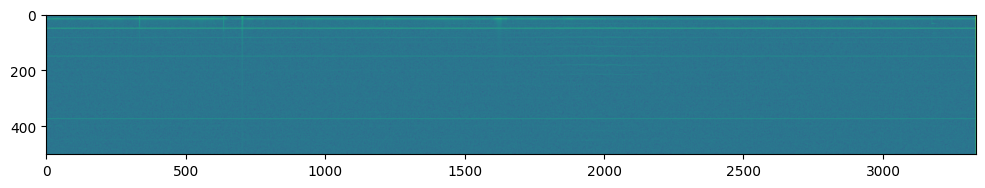

In [7]:
fig,ax = plt.subplots(figsize=(12,8))
ax.imshow(np.log(np.abs(Zxx)))

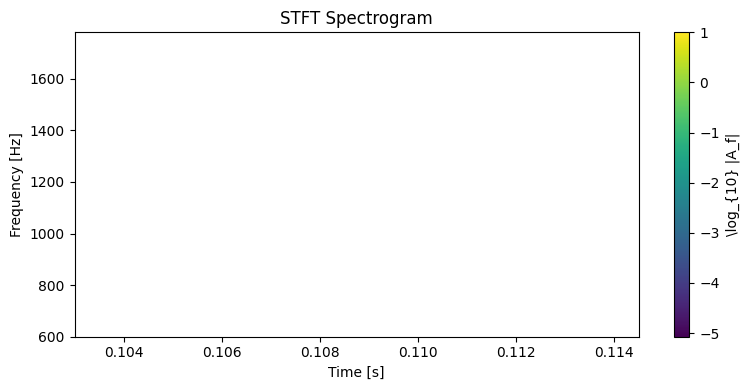

In [8]:
normalize = True
mag = np.log10(np.abs(Zxx))

if normalize:
    mag = mag/np.max(mag)
    
fig, ax = plt.subplots(figsize=(8, 4))

pcm = ax.pcolormesh(t,f,mag)

ax.set_xlabel('Time [s]')
ax.set_ylabel('Frequency [Hz]')
ax.set_title('STFT Spectrogram')

# optional zoom (your numbers from the question)
ax.set_xlim(0.103, 0.1145)
ax.set_ylim(600, 1780)

cbar = fig.colorbar(pcm, ax=ax, label=r'\log_{10} |A_f|')
plt.tight_layout()
plt.show()

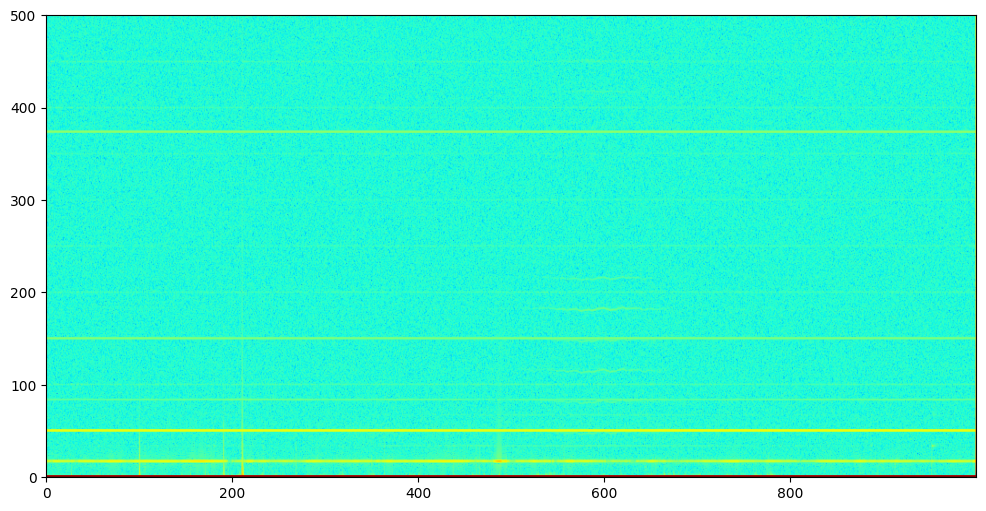

In [38]:
mag = np.log10(np.abs(Zxx))
fig,ax = plt.subplots(figsize=(12,6))
im = ax.imshow(
        mag,
        origin='lower',            # row 0 (bottom) = f_plot[0]  (low freq)
        aspect='auto',             # let x & y scale independently
        extent=[t[0], t[-1],       # x-axis limits  (seconds)
                f[0], f[-1]],   # y-axis limits  (hertz)
        cmap='jet')             # any colormap you like
# ax.set_yscale('log')

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import ShortTimeFFT
from scipy.signal.windows import gaussian
# from scipy.signal.windows import hamming

T_x, N = 1. / fs, len(data)  # 20 Hz sampling rate for 50 s signal
t_x = np.arange(N) * T_x  # time indexes for signal
# f_i = 1 * np.arctan((t_x - t_x[N // 2]) / 2) + 5  # varying frequency
# x = np.sin(2*np.pi*np.cumsum(f_i)*T_x) # the signal

In [10]:
g_std = 1000  # standard deviation for Gaussian window in samples
w = gaussian(1000, std=g_std, sym=True)  # symmetric Gaussian window
SFT = ShortTimeFFT(w, hop=1000, fs=fs, mfft=1000, scale_to='magnitude')
Sx = SFT.stft(data)  # perform the STFT

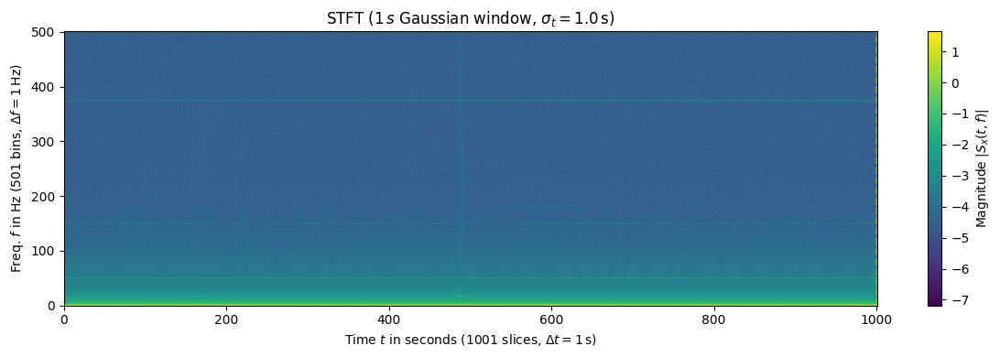

In [11]:
fig1, ax1 = plt.subplots(figsize=(12., 4.))  # enlarge plot a bit
t_lo, t_hi = SFT.extent(N)[:2]  # time range of plot
ax1.set_title(rf"STFT ({SFT.m_num*SFT.T:g}$\,s$ Gaussian window, " +
              rf"$\sigma_t={g_std*SFT.T}\,$s)")
ax1.set(xlabel=f"Time $t$ in seconds ({SFT.p_num(N)} slices, " +
               rf"$\Delta t = {SFT.delta_t:g}\,$s)",
        ylabel=f"Freq. $f$ in Hz ({SFT.f_pts} bins, " +
               rf"$\Delta f = {SFT.delta_f:g}\,$Hz)",
        xlim=(t_lo, t_hi))
im1 = ax1.imshow(np.log10(abs(Sx)), origin='lower', aspect='auto',
                 extent=SFT.extent(N), cmap='viridis')

fig1.colorbar(im1, label="Magnitude $|S_x(t, f)|$")

for t0_, t1_ in [(t_lo, SFT.lower_border_end[0] * SFT.T),
                 (SFT.upper_border_begin(N)[0] * SFT.T, t_hi)]:
    ax1.axvspan(t0_, t1_, color='w', linewidth=0, alpha=.2)
for t_ in [0, N * SFT.T]:  # mark signal borders with vertical line:
    ax1.axvline(t_, color='y', linestyle='--', alpha=0.5)
    
fig1.tight_layout()
plt.show()

# Test of waterfall generation

In [12]:
fs = 1000.
directory = '/home/gw-group/20250605_Bedretto/'
dset = load_csv(directory+'mag_2025_06_04_15_04.csv')
x = dset['x']

In [13]:
res_x = gaussian_stft(x,fs,g_std=1000,g_length=8192,mfft=8192,hop=1024)

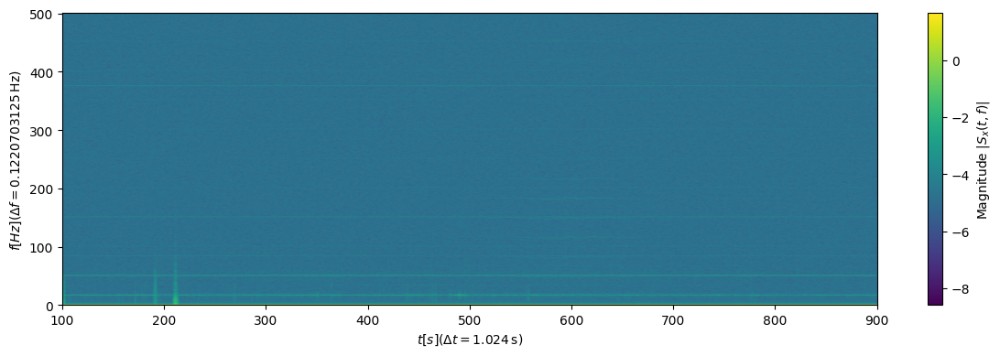

In [14]:
fig, ax = plt.subplots(figsize=(12., 4.))
t_lo,t_hi = res_x['extent'][:2]
sx = res_x['sx']
ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res_x['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res_x['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res_x['extent'], cmap='viridis')
ax.set_xlim(100,900)

fig.colorbar(im, label="Magnitude $|S_x(t, f)|$")

fig.tight_layout()
plt.show()

In [15]:
res_y = gaussian_stft(dset['y'],fs,g_std=1000,g_length=8192,mfft=16384,hop=1024)

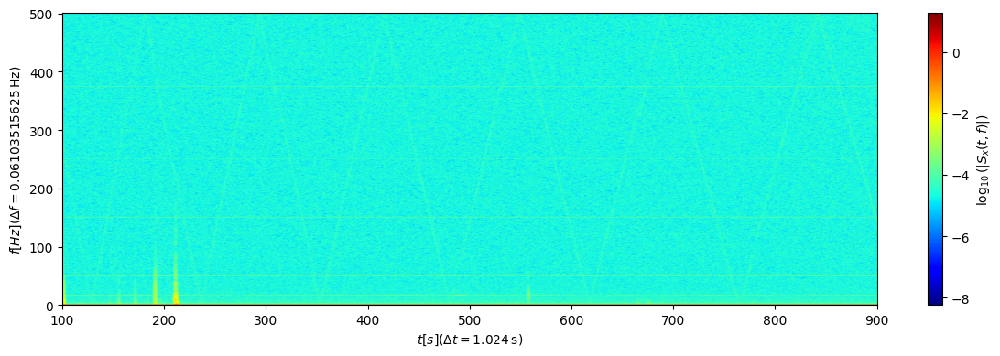

In [16]:
fig, ax = plt.subplots(figsize=(12., 4.))
t_lo,t_hi = res_y['extent'][:2]
sx = res_y['sx']
ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res_y['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res_y['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res_y['extent'], cmap='jet')
ax.set_xlim(100,900)

fig.colorbar(im, label=r"$\log_{10}(|S_x(t, f)|)$")

fig.tight_layout()
plt.savefig('mag_2025_06_04_15_04_waterfall_y',dpi=200)
# plt.show()

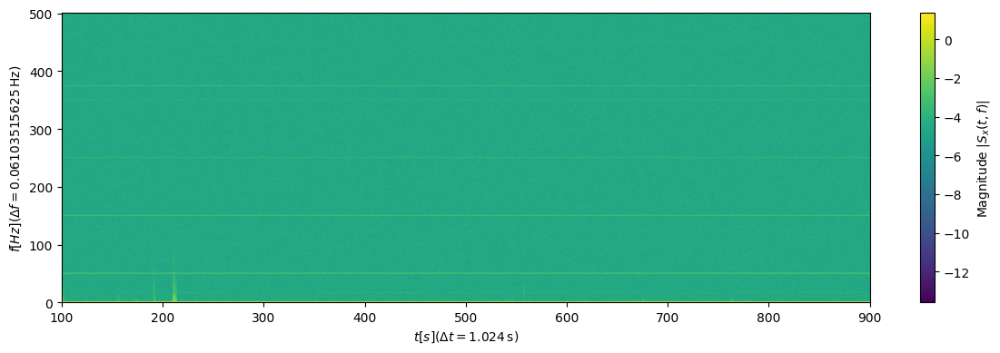

In [17]:
res_z = gaussian_stft(dset['z'],fs,g_std=500,g_length=8192,mfft=16384,hop=1024)
fig, ax = plt.subplots(figsize=(12., 4.))
t_lo,t_hi = res_z['extent'][:2]
sx = res_z['sx']
ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res_z['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res_z['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res_z['extent'], cmap='viridis')
ax.set_xlim(100,900)

fig.colorbar(im, label="Magnitude $|S_x(t, f)|$")

fig.tight_layout()
plt.show()

In [123]:
import os
directory = '/home/gw-group/20250605_Bedretto/'
filelist = os.listdir(directory)
print(filelist)

['mag_2025_06_05_12_43.csv', 'mag_2025_06_05_11_04.csv', 'mag_2025_06_05_12_49.csv', 'mag_2025_06_05_10_13.csv', 'mag_2025_06_05_10_47.csv', 'mag_2025_06_05_09_44.csv', 'mag_2025_06_05_09_27.csv', 'log.txt', 'mag_2025_06_05_12_45.csv', 'mag_2025_06_05_09_10.csv', 'mag_2025_06_05_12_47.csv', 'mag_2025_06_04_15_02.csv', 'mag_2025_06_05_10_30.csv', 'mag_2025_06_04_15_04.csv']


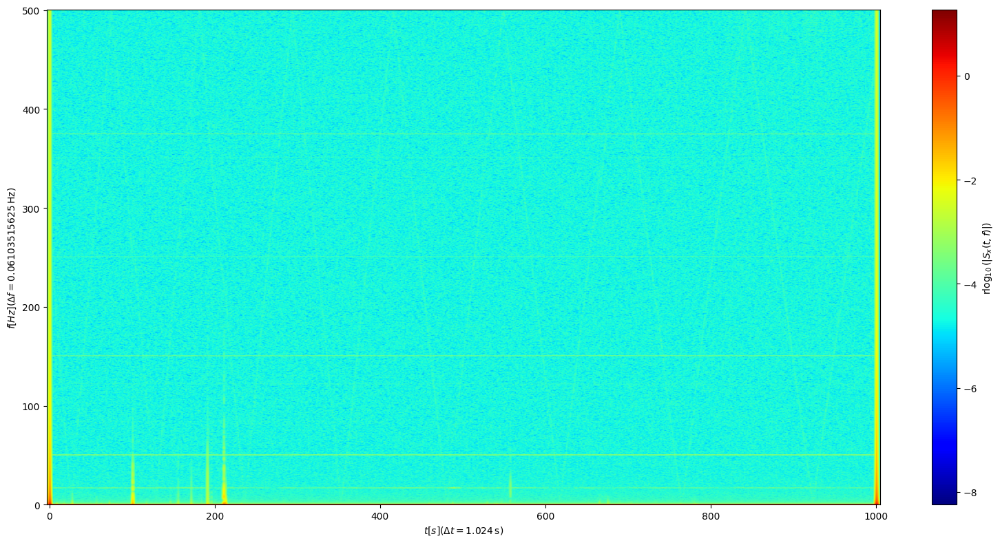

In [23]:
path = '/home/gw-group/20250605_Bedretto/mag_2025_06_04_15_04.csv'
dset = load_csv(path)
fs = 1000.
res = gaussian_stft(dset['y'],fs,g_std=1000,g_length=8192,mfft=16384,hop=1024)

fig, ax = plt.subplots(figsize=(16., 8.))
t_lo,t_hi = res['extent'][:2]
sx = res['sx']

ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res['extent'], cmap='jet')
fig.colorbar(im, label="r$\log_{10}(|S_x(t, f)|)$")
# ax.set_ylim([0,200])
# ax.set_xlim([50,100])

fig.tight_layout()
plt.show()

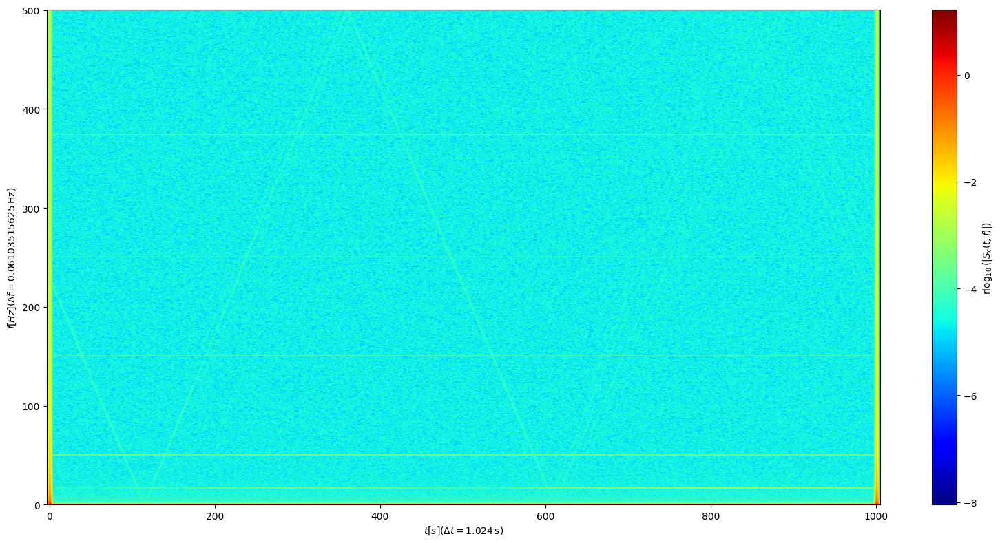

In [20]:
path = '/home/gw-group/20250605_Bedretto/mag_2025_06_05_11_04.csv'
dset = load_csv(path)
fs = 1000.
res = gaussian_stft(dset['y'],fs,g_std=1000,g_length=8192,mfft=16384,hop=1024)

fig, ax = plt.subplots(figsize=(16., 8.))
t_lo,t_hi = res['extent'][:2]
sx = res['sx']

ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res['extent'], cmap='jet')
fig.colorbar(im, label="r$\log_{10}(|S_x(t, f)|)$")
# ax.set_ylim([0,200])
# ax.set_xlim([50,100])

fig.tight_layout()
plt.show()

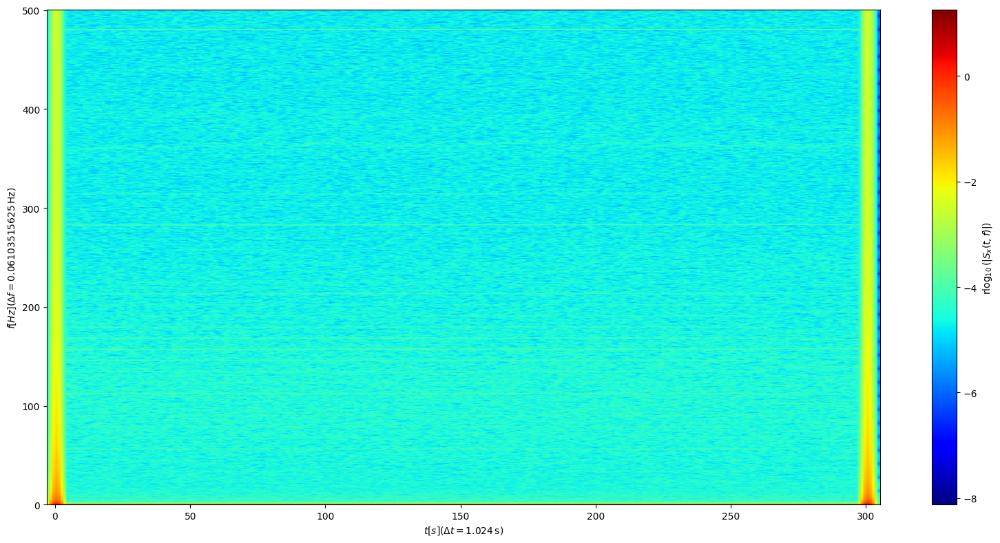

In [22]:
path = '/home/gw-group/20250605_Bedretto/mag_2025_06_05_12_49.csv'
dset = load_csv(path)
fs = 1000.
res = gaussian_stft(dset['y'],fs,g_std=1000,g_length=8192,mfft=16384,hop=1024)

fig, ax = plt.subplots(figsize=(16., 8.))
t_lo,t_hi = res['extent'][:2]
sx = res['sx']

ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res['extent'], cmap='jet')
fig.colorbar(im, label="r$\log_{10}(|S_x(t, f)|)$")
# ax.set_ylim([0,200])
# ax.set_xlim([50,100])

fig.tight_layout()
plt.show()

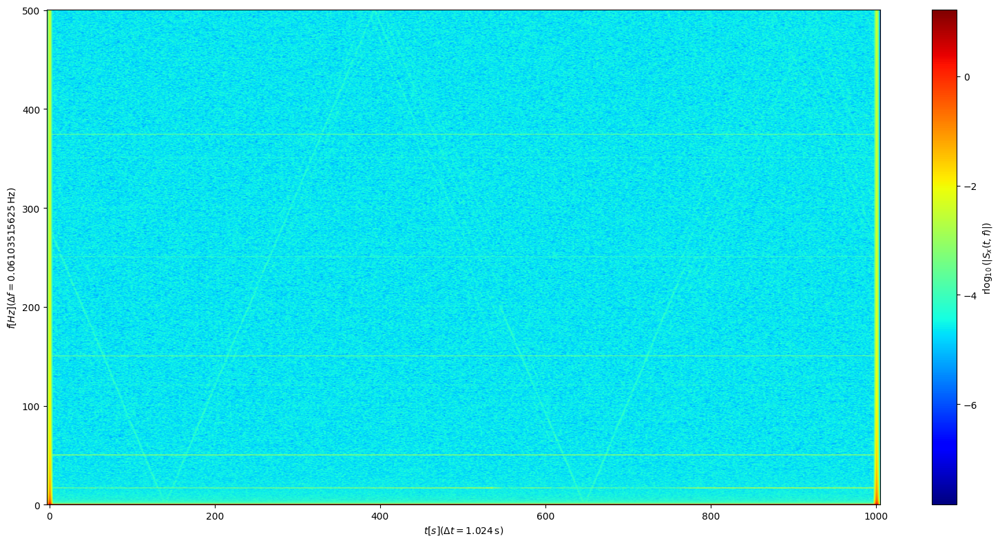

In [24]:
path = '/home/gw-group/20250605_Bedretto/mag_2025_06_05_10_30.csv'
dset = load_csv(path)
fs = 1000.
res = gaussian_stft(dset['y'],fs,g_std=1000,g_length=8192,mfft=16384,hop=1024)

fig, ax = plt.subplots(figsize=(16., 8.))
t_lo,t_hi = res['extent'][:2]
sx = res['sx']

ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res['extent'], cmap='jet')
fig.colorbar(im, label="r$\log_{10}(|S_x(t, f)|)$")
# ax.set_ylim([0,200])
# ax.set_xlim([50,100])

fig.tight_layout()
plt.show()

# generate all waterfalls

['mag_2025_06_05_12_43.csv', 'mag_2025_06_05_11_04.csv', 'mag_2025_06_05_12_49.csv', 'mag_2025_06_05_10_13.csv', 'mag_2025_06_05_10_47.csv', 'mag_2025_06_05_09_44.csv', 'mag_2025_06_05_09_27.csv', 'log.txt', 'mag_2025_06_05_12_45.csv', 'mag_2025_06_05_09_10.csv', 'mag_2025_06_05_12_47.csv', 'mag_2025_06_04_15_02.csv', 'mag_2025_06_05_10_30.csv', 'mag_2025_06_04_15_04.csv']


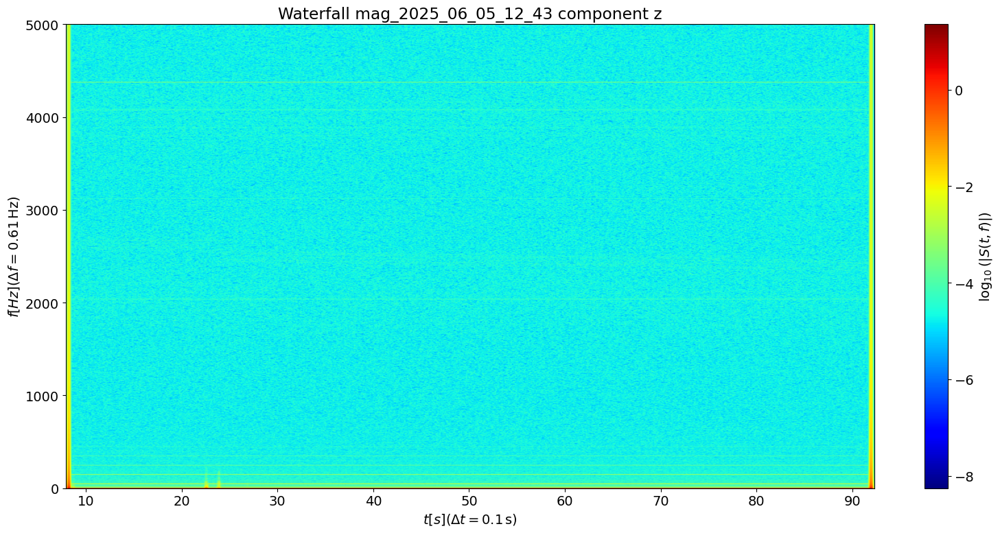

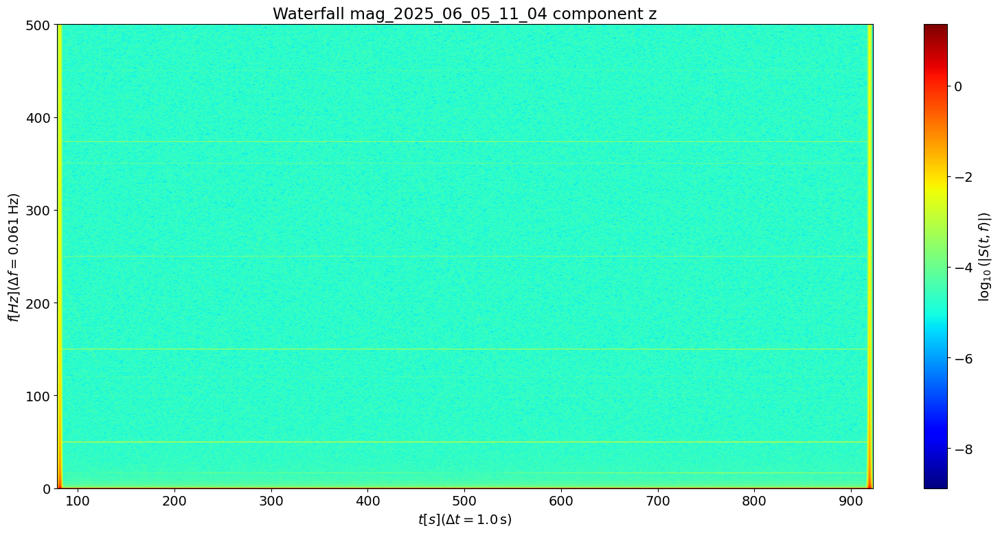

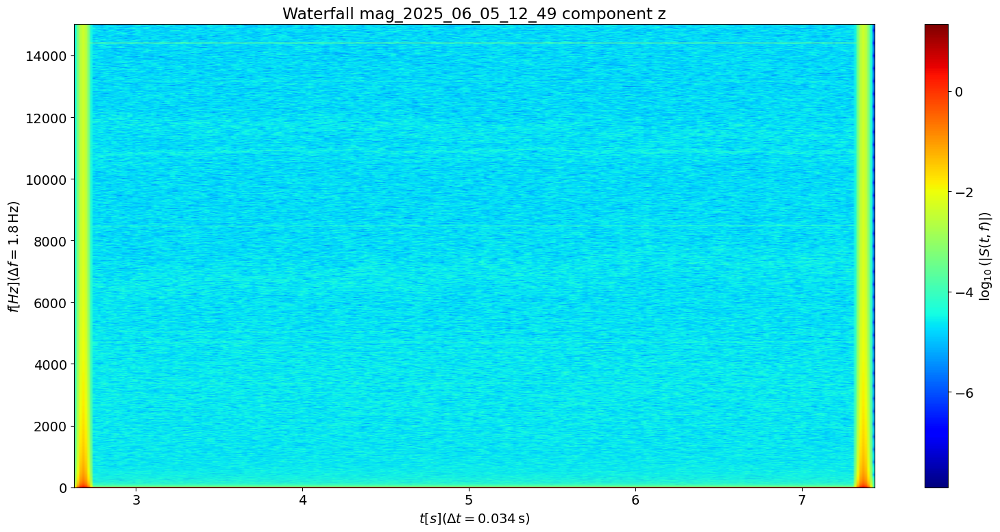

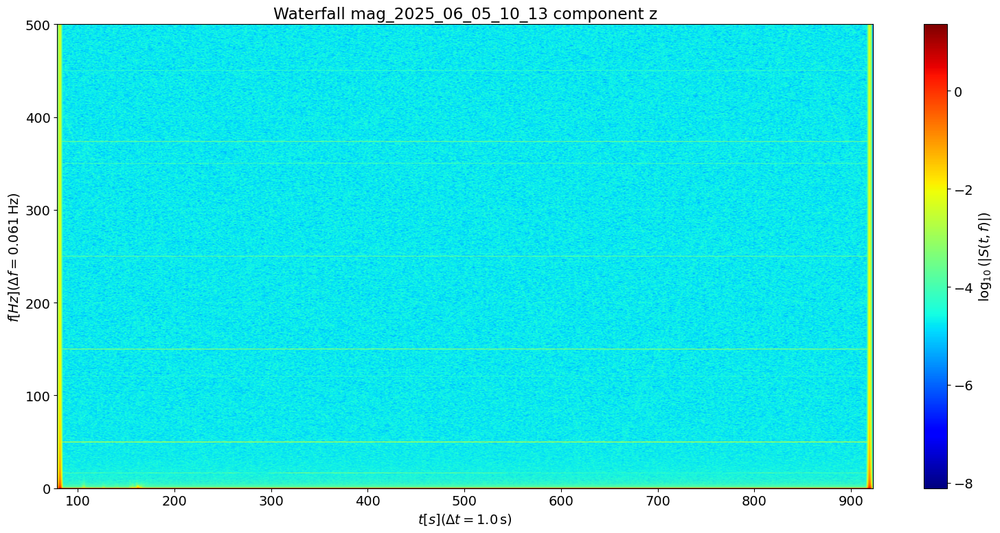

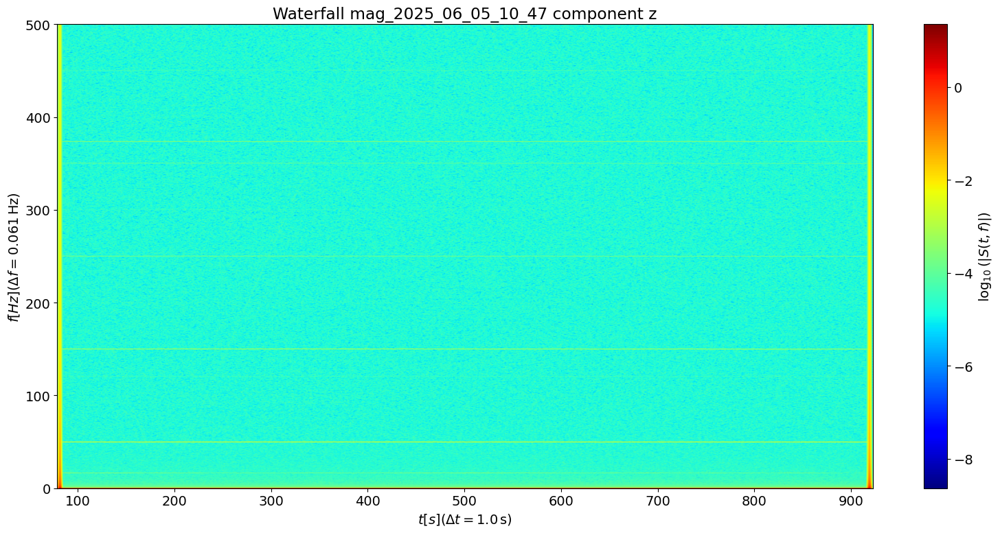

...

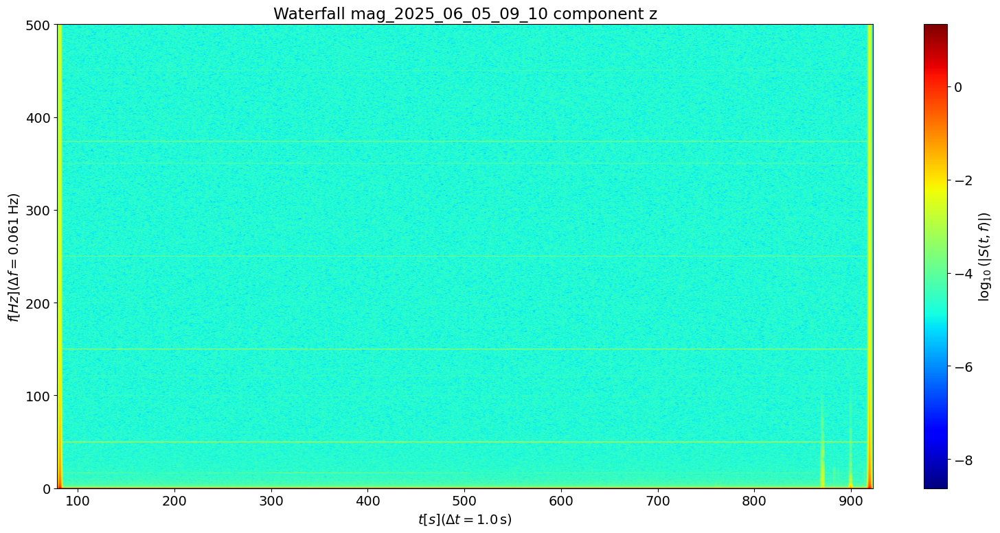

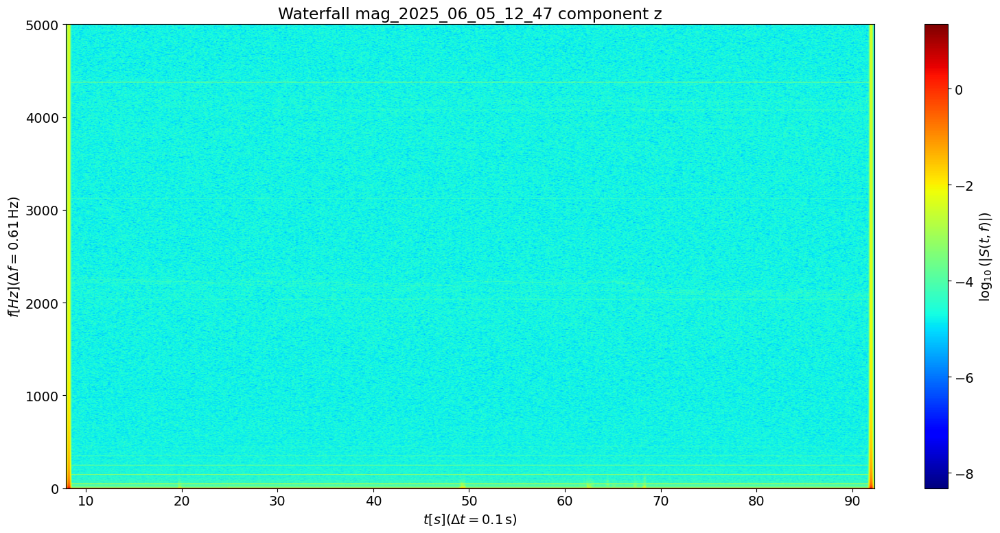

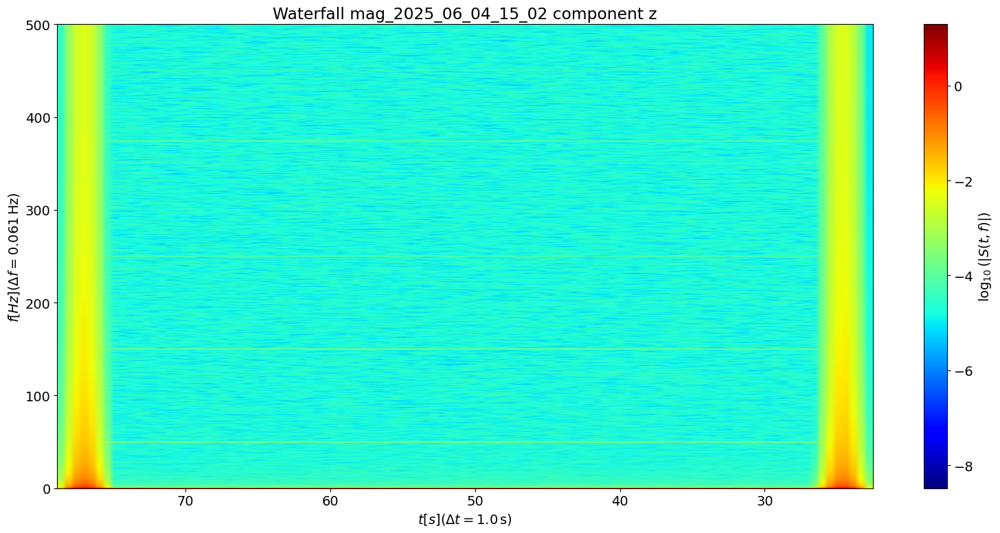

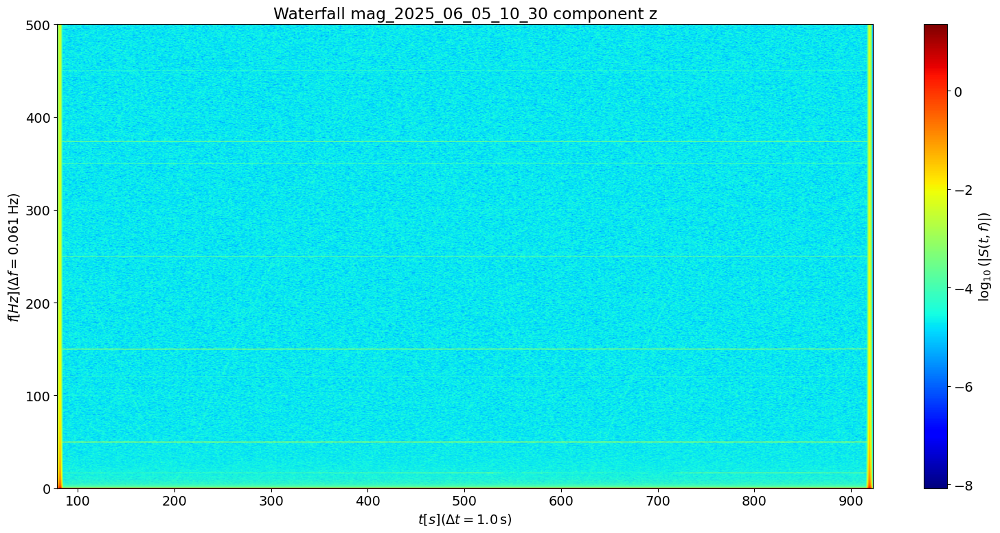

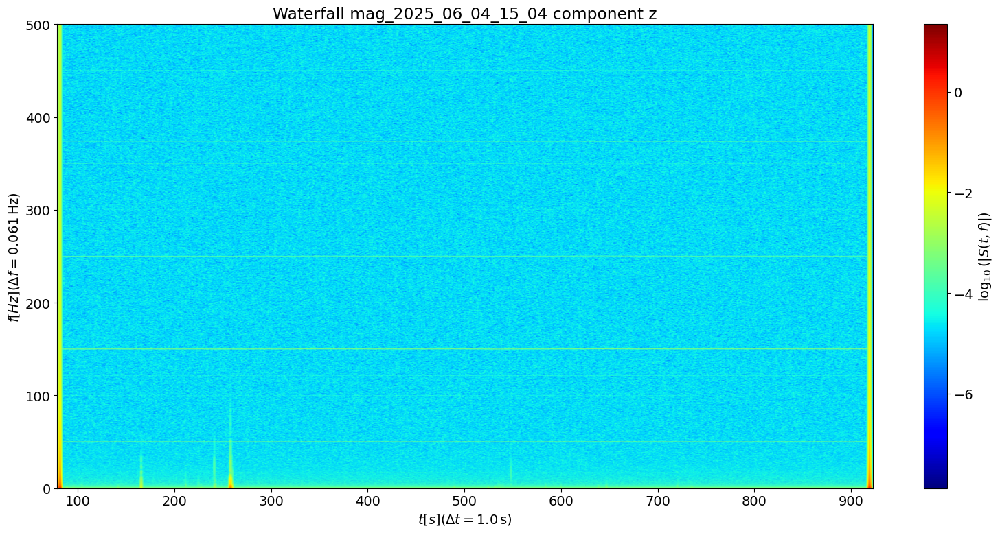

In [19]:
import os
orientation = 'z'
directory = '/home/gw-group/20250605_Bedretto/'
filelist = os.listdir(directory)
outdirectory = f'/home/gw-group/gdzhao/20250605_Bedretto_waterfall/component_{orientation}/'
print(filelist)

if not os.path.exists(outdirectory):
    os.mkdir(outdirectory)

for name in filelist:
    if name.endswith('.txt'):
        continue
    
    fs = 1000.
    if name in ['mag_2025_06_05_12_43.csv','mag_2025_06_05_12_45.csv','mag_2025_06_05_12_47.csv']:
        fs = 10000.
    elif name in ['mag_2025_06_05_12_49.csv']:
        fs = 30018.
    # else:
    #     continue
        
    path = '/home/gw-group/20250605_Bedretto/'+name
    dset = load_csv(path)
    
    res = gaussian_stft(dset[orientation],fs,g_std=1000,g_length=8192,mfft=16384,hop=1024)
    
    fig, ax = plt.subplots(figsize=(16., 8.))
    t_lo,t_hi = res['extent'][:2]
    t_lo_amputate = t_lo+res['delta_t']*80
    t_hi_amputate = t_hi-res['delta_t']*80
    f_lo = res['extent'][2]
    f_hi = res['extent'][3]

    extent = [t_lo_amputate,t_hi_amputate,f_lo,f_hi]
    
    sx = res['sx']
    
    ax.set(xlabel=f"$t[s]$" +
                   rf"($\Delta t = {res['delta_t']:.2}\,$s)",
            ylabel=f"$f[Hz]$" +
                   rf"($\Delta f = {res['delta_f']:.2}\,$Hz)",
            xlim=(t_lo_amputate, t_hi_amputate))
    im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
                   extent=extent, cmap='jet')
    ax.set_title(f'Waterfall {name[:-4]} component {orientation}')
    fig.colorbar(im, label=r"$\log_{10}(|S(t, f)|)$")
    # ax.set_ylim([0,200])
    # ax.set_xlim([50,100])
    
    fig.tight_layout()
    filename = name[:-4]
    fig.savefig(outdirectory+filename+'_g1000.pdf')

# Local data

In [108]:
path = './bigmag_test4/mag_2025_06_12_09_29.hdf5'
dset = load_hdf5(path)

In [109]:
x = dset['x']
fs = dset['sample_rate']

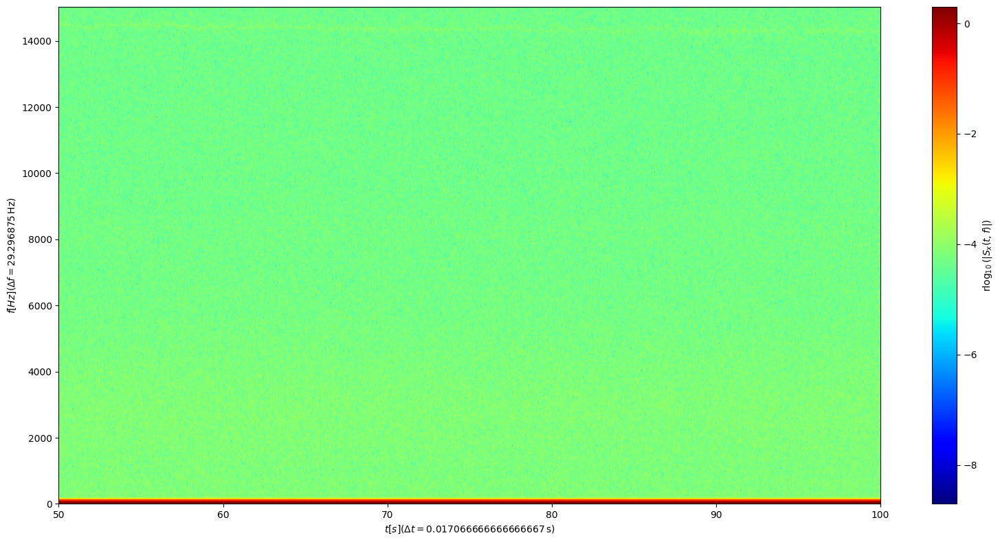

In [118]:
res_x = gaussian_stft(x,fs,g_std=128,g_length=1024,mfft=1024,hop=512)
fig, ax = plt.subplots(figsize=(16., 8.))
t_lo,t_hi = res_x['extent'][:2]
sx = res_x['sx']
ax.set(xlabel=f"$t[s]$" +
               rf"($\Delta t = {res_x['delta_t']}\,$s)",
        ylabel=f"$f[Hz]$" +
               rf"($\Delta f = {res_x['delta_f']}\,$Hz)",
        xlim=(t_lo, t_hi))
im = ax.imshow(np.log10(np.abs(sx)), origin='lower', aspect='auto',
               extent=res_x['extent'], cmap='jet')
fig.colorbar(im, label="r$\log_{10}(|S_x(t, f)|)$")
# ax.set_ylim([0,200])
ax.set_xlim([50,100])

fig.tight_layout()
plt.show()

# Local very long acquisition